This based off of the tutorial from scanpy using pbmc 3K.
https://scanpy-tutorials.readthedocs.io/en/latest/pbmc3k.html

And heavily influenced by https://github.com/theislab/scanpy_usage/blob/master/170503_zheng17/zheng17.ipynb

We are interested in understanding the changes in the synovium due to Tocilizumab treatment. 
This notebook is the QC analysis for the single-cell untreated synovium data from Zhang, F. et al. Deconstruction of rheumatoid arthritis synovium defines inflammatory subtypes. Nature 623, 616–624 (2023).
DOI:10.1038/s41586-023-06708-y

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
from matplotlib.pyplot import rc_context

import os

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')


/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/davidnat/

scanpy==1.8.2 anndata==0.8.0 umap==0.5.2 numpy==1.23.5 scipy==1.8.1 pandas==1.5.3 scikit-learn==1.3.1 statsmodels==0.14.0 python-igraph==0.10.8 pynndescent==0.5.10


## Open files

In [2]:
data_path = f"{os.getcwd()}/../../data/single_cell_data/synovium/"

# data downloaded from figshare link provided in Tabula Muris Senis paper
# URL to data is provided in the BuDDI manuscript

in_file = f"{data_path}/synovium_raw_reference.h5ad"
results_file = f"{data_path}/synovium_processed.h5ad"
clinical_file = f"{data_path}/metadata_clin_donor_singlecell.csv"


adata = sc.read_h5ad(in_file)
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`



In [3]:
adata.var

,features
MIR1302-2HG,MIR1302-2HG
FAM138A,FAM138A
OR4F5,OR4F5
AL627309.1,AL627309.1
AL627309.3,AL627309.3
...,...
AC233755.2,AC233755.2
AC233755.1,AC233755.1
AC240274.1,AC240274.1
AC213203.1,AC213203.1


In [4]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,cell,sample,cluster_number,cluster_name,cell_type
BRI-399_ACACAGTAGAAAGCGA,BRI-399,3999.0,1697,BRI-399_ACACAGTAGAAAGCGA,BRI-399,NK-1,NK-1: CD56dim CD16+ IFNG+CD160+,NK
BRI-399_AGACCATGTGGTTCTA,BRI-399,1095.0,531,BRI-399_AGACCATGTGGTTCTA,BRI-399,NK-9,NK-9: MT-high,NK
BRI-399_AGTTCCCCATCAGCGC,BRI-399,5379.0,1789,BRI-399_AGTTCCCCATCAGCGC,BRI-399,NK-12,NK-12: IL7R+ ILC,NK
BRI-399_ATGCCTCGTAGACAAT,BRI-399,4147.0,1912,BRI-399_ATGCCTCGTAGACAAT,BRI-399,NK-0,NK-0: CD56dim CD16+ IFNG-,NK
BRI-399_CACACAAAGAGGGTGG,BRI-399,3064.0,1255,BRI-399_CACACAAAGAGGGTGG,BRI-399,NK-12,NK-12: IL7R+ ILC,NK
...,...,...,...,...,...,...,...,...
BRI-619_TTTCACAGTCCTGTTC,BRI-619,8726.0,2307,BRI-619_TTTCACAGTCCTGTTC,BRI-619,T-16,T-16: CD8+ CD45ROlow/naive,T
BRI-623_TCGGTCTGTACCTAAC,BRI-623,12455.0,3162,BRI-623_TCGGTCTGTACCTAAC,BRI-623,T-17,T-17: CD8+ activated/NK-like,T
BRI-625_AGAGCAGCAGATCCTA,BRI-625,6185.0,2000,BRI-625_AGAGCAGCAGATCCTA,BRI-625,T-17,T-17: CD8+ activated/NK-like,T
BRI-625_TCATTACTCTATTGTC,BRI-625,17007.0,3858,BRI-625_TCATTACTCTATTGTC,BRI-625,T-0,T-0: CD4+ IL7R+ memory,T


We are going to divide the cell type groups into a bit more descriptive subsections

In [5]:
adata.obs["cell_type_orig"] = adata.obs.cell_type

In [6]:
tab = adata.obs.iloc[np.where(adata.obs.cell_type=="NK")[0]].groupby(['cluster_name', 'cell_type']).size()

tab.unstack()

cell_type,NK
cluster_name,
NK-0: CD56dim CD16+ IFNG-,1513
NK-10: PCNA+ Proliferating,149
NK-11: MKI67+ Proliferating,88
NK-12: IL7R+ ILC,735
NK-13: IL7R+CD161+ ILC,131
NK-1: CD56dim CD16+ IFNG+CD160+,1415
NK-2: CD56dim CD16+ IFNG+CD160-,745
NK-3: CD56dim CD16+ GZMB-,59
NK-4: CD56bright CD16- GZMA+CD160+,1021


In [7]:
tab = adata.obs.iloc[np.where(adata.obs.cell_type=="Endothelial")[0]].groupby(['cluster_name', 'cell_type']).size()

tab.unstack()

cell_type,Endothelial
cluster_name,
E-0: SPARC+ capillary,8819
E-1: LIFR+ venular,7588
E-2: ICAM1+ venular,5594
E-3: NOTCH4+ arteriolar,2636
E-4: Lymphatic,406


In [8]:
tab = adata.obs.iloc[np.where(adata.obs.cell_type=="B")[0]].groupby(['cluster_name', 'cell_type']).size()

tab.unstack()

cell_type,B
cluster_name,
B-0: CD24+CD27+CD11b+ switched memory,6708
B-1: CD24++CD27+IgM+ unswitched memory,3801
B-2: IgM+IgD+TCL1A+ naive,6073
B-3: IgM+IgD+CD1c+ MZ-like,2687
B-4: AICDA+BCL6+ GC-like,338
B-5: CD11c+LAMP1+ ABC,1973
B-6: IgM+ plasma,1831
B-7: HLA-DR+IgG+ plasmablast,1695
B-8: IgG1+IgG3+ plasma,5585


In [9]:
tab = adata.obs.iloc[np.where(adata.obs.cell_type=="T")[0]].groupby(['cluster_name', 'cell_type']).size()

tab.unstack()

cell_type,T
cluster_name,
T-0: CD4+ IL7R+ memory,9902
T-10: CD4+ OX40+NR3C1+,2553
T-11: CD4+ CD146+ memory,1867
T-12: CD4+ GNLY+,1604
T-13: CD8+ GZMK/B+ memory,8693
T-14: CD8+ GZMK+ memory,6870
T-15: CD8+ GZMB+/TEMRA,4723
T-16: CD8+ CD45ROlow/naive,4554
T-17: CD8+ activated/NK-like,692


In [10]:
t_cd4_idx = np.where(np.isin(adata.obs.cluster_number, ["T-0", "T-1", "T-2", "T-3", "T-4", "T-5",
                                                        "T-6", "T-7", "T-8", "T-9", "T-10", "T-11",
                                                        "T-12"]))[0]

t_cd8_idx = np.where(np.isin(adata.obs.cluster_number, ["T-13", "T-14", "T-15", "T-16", "T-17"]))[0]
                                                        
t_other_idx = np.where(np.isin(adata.obs.cluster_number, ["T-18", "T-19", "T-20",
                                                        "T-21", "T-22", "T-23"]))[0]
adata.obs.cell_type.iloc[t_cd4_idx] = "T_CD4"
adata.obs.cell_type.iloc[t_cd8_idx] = "T_CD8"
adata.obs.cell_type.iloc[t_other_idx] = "T_other"

tab = adata.obs.iloc[np.where(adata.obs.cell_type_orig=="T")[0]].groupby(['cluster_name', 'cell_type']).size()
tab.unstack()

/var/folders/64/dljh4z4j4vq9yn4f7wkb2k1h0000gp/T/ipykernel_83655/2402372101.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs.cell_type.iloc[t_cd4_idx] = "T_CD4"
/var/folders/64/dljh4z4j4vq9yn4f7wkb2k1h0000gp/T/ipykernel_83655/2402372101.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs.cell_type.iloc[t_cd8_idx] = "T_CD8"
/var/folders/64/dljh4z4j4vq9yn4f7wkb2k1h0000gp/T/ipykernel_83655/2402372101.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

cell_type,T_CD4,T_CD8,T_other
cluster_name,,,
T-0: CD4+ IL7R+ memory,9902.0,NaN,NaN
T-10: CD4+ OX40+NR3C1+,2553.0,NaN,NaN
T-11: CD4+ CD146+ memory,1867.0,NaN,NaN
T-12: CD4+ GNLY+,1604.0,NaN,NaN
T-13: CD8+ GZMK/B+ memory,NaN,8693.0,NaN
T-14: CD8+ GZMK+ memory,NaN,6870.0,NaN
T-15: CD8+ GZMB+/TEMRA,NaN,4723.0,NaN
T-16: CD8+ CD45ROlow/naive,NaN,4554.0,NaN
T-17: CD8+ activated/NK-like,NaN,692.0,NaN


In [11]:
# add clinical info to metadata
clinical_df = pd.read_csv(clinical_file)
new_meta = adata.obs.merge(clinical_df, left_on="sample", right_on="mRNA_run")
new_meta.index = new_meta["cell"]
adata.obs = new_meta

In [12]:
adata.obs_keys

<bound method AnnData.obs_keys of AnnData object with n_obs × n_vars = 314011 × 33538
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell', 'sample', 'cluster_number', 'cluster_name', 'cell_type', 'cell_type_orig', 'subject_id', 'pipeline_date', 'site', 'treatment', 'biopsied', 'sex', 'age', 'CDAI', 'disease_duration', 'tissue_type', 'krenn_lining', 'krenn_inflammation', 'single_cell_tech', 'cell_count_to_10x', 'mRNA_run', 'protein_run', 'atac_run', 'qc'
    var: 'features'>

In [13]:
adata.obs[["treatment", 'mRNA_run', 'orig.ident', 'subject_id', 'pipeline_date', 'site', 'treatment', 'biopsied', 'sex', 'age', 'CDAI', 'disease_duration', 'tissue_type', 'krenn_lining', 'krenn_inflammation', 'single_cell_tech']]


,treatment,mRNA_run,orig.ident,subject_id,pipeline_date,site,treatment,biopsied,sex,age,CDAI,disease_duration,tissue_type,krenn_lining,krenn_inflammation,single_cell_tech
cell,,,,,,,,,,,,,,,,
BRI-399_ACACAGTAGAAAGCGA,4,BRI-399,BRI-399,301-0267,8/6/19,University of Pittsburgh,4,Knee,Female,70,NaN,NaN,Arthroplasty,NaN,NaN,CITEseq + flow/bulk + re-freeze
BRI-399_AGACCATGTGGTTCTA,4,BRI-399,BRI-399,301-0267,8/6/19,University of Pittsburgh,4,Knee,Female,70,NaN,NaN,Arthroplasty,NaN,NaN,CITEseq + flow/bulk + re-freeze
BRI-399_AGTTCCCCATCAGCGC,4,BRI-399,BRI-399,301-0267,8/6/19,University of Pittsburgh,4,Knee,Female,70,NaN,NaN,Arthroplasty,NaN,NaN,CITEseq + flow/bulk + re-freeze
BRI-399_ATGCCTCGTAGACAAT,4,BRI-399,BRI-399,301-0267,8/6/19,University of Pittsburgh,4,Knee,Female,70,NaN,NaN,Arthroplasty,NaN,NaN,CITEseq + flow/bulk + re-freeze
BRI-399_CACACAAAGAGGGTGG,4,BRI-399,BRI-399,301-0267,8/6/19,University of Pittsburgh,4,Knee,Female,70,NaN,NaN,Arthroplasty,NaN,NaN,CITEseq + flow/bulk + re-freeze
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BRI-621_TTTGGTTTCCGACATA,2,BRI-621,BRI-621,300-0469,10/24/19,Northwestern,2,Wrist,Female,58,29.5,4.3,Biopsy,NaN,NaN,CITEseq
BRI-621_CAGTTAGTCAGCTTCC,2,BRI-621,BRI-621,300-0469,10/24/19,Northwestern,2,Wrist,Female,58,29.5,4.3,Biopsy,NaN,NaN,CITEseq
BRI-621_CCAATGAAGTGGTTCT,2,BRI-621,BRI-621,300-0469,10/24/19,Northwestern,2,Wrist,Female,58,29.5,4.3,Biopsy,NaN,NaN,CITEseq


## check number of cells per treatment naive samples

In [14]:
adata.obs["treatment"].value_counts()

1         124722
3          73102
2          71014
4          43589
Repeat      1584
Name: treatment, dtype: int64

In [15]:
adata = adata[adata.obs["treatment"] == "1"]

In [16]:
# how many of each sample
adata.obs["sample"].value_counts()

BRI-462    10648
BRI-566     9638
BRI-458     9327
BRI-460     9103
BRI-421     9031
BRI-601     8244
BRI-605     7971
BRI-515     7944
BRI-415     7370
BRI-623     6044
BRI-436     5655
BRI-550     5046
BRI-542     4980
BRI-401     4299
BRI-419     3897
BRI-413     3545
BRI-625     2323
BRI-475     2258
BRI-570     1299
BRI-440     1284
BRI-627     1085
BRI-562      957
BRI-536      768
BRI-483      607
BRI-554      449
BRI-527      357
BRI-509      303
BRI-503      290
Name: sample, dtype: int64

In [17]:
adata.obs.cell_type.unique()

array(['NK', 'B', 'Endothelial', 'Fibroblast', 'Myeloid', 'T_CD4',
       'T_CD8', 'T_other'], dtype=object)

In [18]:
tab = adata.obs.groupby(['sample', 'cell_type']).size()
a = tab.unstack()
a["min_val"] = a[adata.obs.cell_type.unique()].min(axis=1)
a["total"] = a[adata.obs.cell_type.unique()].sum(axis=1)
a = a.iloc[np.where(np.logical_and(a.total > 1000, a.min_val > 50))]

a

cell_type,B,Endothelial,Fibroblast,Myeloid,NK,T_CD4,T_CD8,T_other,min_val,total
sample,,,,,,,,,,
BRI-415,1830.0,139.0,855.0,800.0,197.0,2567.0,703.0,279.0,139.0,7370.0
BRI-419,493.0,242.0,558.0,1385.0,127.0,715.0,270.0,107.0,107.0,3897.0
BRI-421,427.0,283.0,1795.0,2935.0,432.0,2059.0,772.0,328.0,283.0,9031.0
BRI-436,1121.0,79.0,68.0,741.0,157.0,1827.0,1085.0,577.0,68.0,5655.0
BRI-458,1322.0,319.0,548.0,4286.0,59.0,1791.0,743.0,259.0,59.0,9327.0
BRI-460,811.0,903.0,5378.0,1363.0,110.0,297.0,182.0,59.0,59.0,9103.0
BRI-462,771.0,250.0,3216.0,4923.0,136.0,858.0,346.0,148.0,136.0,10648.0
BRI-475,87.0,90.0,303.0,941.0,183.0,335.0,263.0,56.0,56.0,2258.0
BRI-515,1721.0,461.0,1956.0,546.0,384.0,1675.0,890.0,311.0,311.0,7944.0


In [19]:
top_samps = a.index.to_list()
top_samps

['BRI-415',
 'BRI-419',
 'BRI-421',
 'BRI-436',
 'BRI-458',
 'BRI-460',
 'BRI-462',
 'BRI-475',
 'BRI-515',
 'BRI-542',
 'BRI-566',
 'BRI-601',
 'BRI-605',
 'BRI-623',
 'BRI-625']

In [20]:
# get the IDs of the top samples
# 0:11 because > 5000 and has all cells (sample 550 is missing Bcells)
#top_samps = adata.obs["sample"].value_counts().index[0:11] 

adata = adata[adata.obs["sample"].isin(top_samps)]

adata.obs["sample"].value_counts()

BRI-462    10648
BRI-566     9638
BRI-458     9327
BRI-460     9103
BRI-421     9031
BRI-601     8244
BRI-605     7971
BRI-515     7944
BRI-415     7370
BRI-623     6044
BRI-436     5655
BRI-542     4980
BRI-419     3897
BRI-625     2323
BRI-475     2258
Name: sample, dtype: int64

In [21]:
# how many of each cell
adata.obs.cell_type.value_counts()

Myeloid        26316
Fibroblast     23603
T_CD4          19877
B              12554
T_CD8          10238
Endothelial     4968
T_other         3815
NK              3062
Name: cell_type, dtype: int64

## Preprocessing

In [22]:
adata.obs["immune_cell"] = "immune_cell"
adata.obs.immune_cell.iloc[np.where(adata.obs.cell_type == "Fibroblast")] = "nonimmune_cell"
adata.obs.immune_cell.iloc[np.where(adata.obs.cell_type == "Endothelial")] = "nonimmune_cell"

tab = adata.obs.groupby(['sample', 'immune_cell']).size()
tab.unstack()

/var/folders/64/dljh4z4j4vq9yn4f7wkb2k1h0000gp/T/ipykernel_83655/2989921808.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["immune_cell"] = "immune_cell"
/Users/davidnat/.pyenv/versions/3.10.1/lib/python3.10/contextlib.py:142: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)
/var/folders/64/dljh4z4j4vq9yn4f7wkb2k1h0000gp/T/ipykernel_83655/2989921808.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs.immune_cell.iloc[np.where(adata.obs.cell_type == "Fibroblast")] = "nonimmune_cell"
/var/folders/64/dljh4z4j4vq

immune_cell,immune_cell,nonimmune_cell
sample,,
BRI-415,6376,994
BRI-419,3097,800
BRI-421,6953,2078
BRI-436,5508,147
BRI-458,8460,867
BRI-460,2822,6281
BRI-462,7182,3466
BRI-475,1865,393
BRI-515,5527,2417


In [23]:
a = tab.unstack()
a["total"] = a.immune_cell + a.nonimmune_cell
a["prop"] = a.immune_cell / a.total
a.iloc[np.where(a.prop < 0.75)]



immune_cell,immune_cell,nonimmune_cell,total,prop
sample,,,,
BRI-460,2822,6281,9103,0.310008
BRI-462,7182,3466,10648,0.674493
BRI-515,5527,2417,7944,0.695745
BRI-601,4032,4212,8244,0.489083
BRI-605,5330,2641,7971,0.668674
BRI-625,1605,718,2323,0.690917


In [24]:
a.iloc[np.where(a.prop > 0.75)]


immune_cell,immune_cell,nonimmune_cell,total,prop
sample,,,,
BRI-415,6376,994,7370,0.865129
BRI-419,3097,800,3897,0.794714
BRI-421,6953,2078,9031,0.769904
BRI-436,5508,147,5655,0.974005
BRI-458,8460,867,9327,0.907044
BRI-475,1865,393,2258,0.825952
BRI-542,4191,789,4980,0.841566
BRI-566,7269,2369,9638,0.754202
BRI-623,5645,399,6044,0.933984


In [25]:
tab = adata.obs.groupby(['sample', 'cell_type']).size()

tab.unstack()

cell_type,B,Endothelial,Fibroblast,Myeloid,NK,T_CD4,T_CD8,T_other
sample,,,,,,,,
BRI-415,1830,139,855,800,197,2567,703,279
BRI-419,493,242,558,1385,127,715,270,107
BRI-421,427,283,1795,2935,432,2059,772,328
BRI-436,1121,79,68,741,157,1827,1085,577
BRI-458,1322,319,548,4286,59,1791,743,259
BRI-460,811,903,5378,1363,110,297,182,59
BRI-462,771,250,3216,4923,136,858,346,148
BRI-475,87,90,303,941,183,335,263,56
BRI-515,1721,461,1956,546,384,1675,890,311


normalizing counts per cell
    finished (0:00:01)


/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/seaborn/categorical.py:82: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


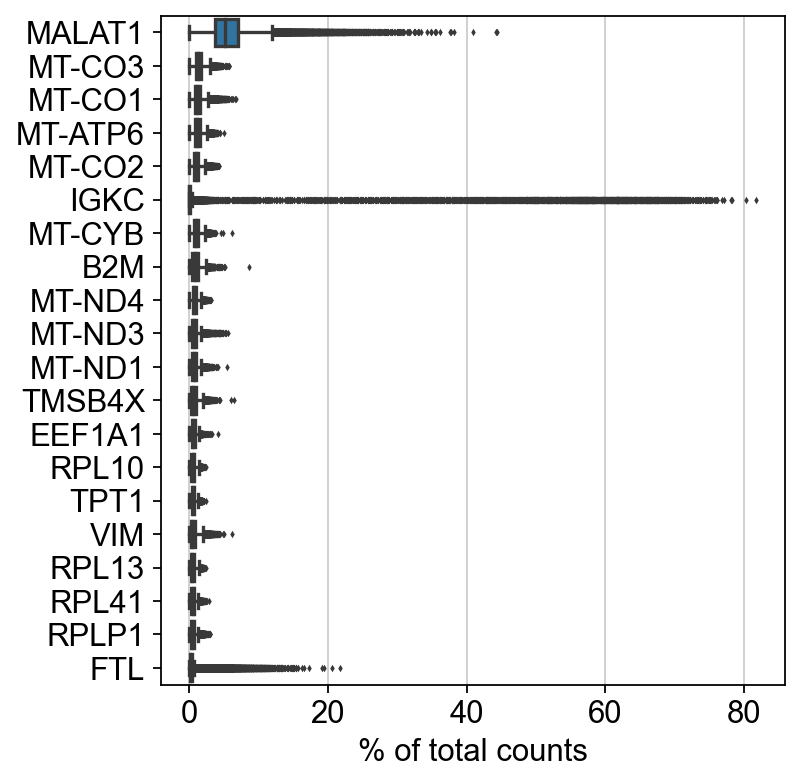

In [26]:
sc.pl.highest_expr_genes(adata, n_top=20, )


In [27]:
# filter out cells with less than 500 genes and genes expressed in less than 100 cells
sc.pp.filter_cells(adata, min_genes=500)
sc.pp.filter_genes(adata, min_cells=100)

filtered out 13772 genes that are detected in less than 100 cells


In [28]:
adata

AnnData object with n_obs × n_vars = 104433 × 19766
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell', 'sample', 'cluster_number', 'cluster_name', 'cell_type', 'cell_type_orig', 'subject_id', 'pipeline_date', 'site', 'treatment', 'biopsied', 'sex', 'age', 'CDAI', 'disease_duration', 'tissue_type', 'krenn_lining', 'krenn_inflammation', 'single_cell_tech', 'cell_count_to_10x', 'mRNA_run', 'protein_run', 'atac_run', 'qc', 'immune_cell', 'n_genes'
    var: 'features', 'n_cells'

In [29]:
tab = adata.obs.groupby(['sample', 'cell_type']).size()

tab.unstack()

cell_type,B,Endothelial,Fibroblast,Myeloid,NK,T_CD4,T_CD8,T_other
sample,,,,,,,,
BRI-415,1830,139,855,800,197,2567,703,279
BRI-419,493,242,558,1385,127,715,270,107
BRI-421,427,283,1795,2935,432,2059,772,328
BRI-436,1121,79,68,741,157,1827,1085,577
BRI-458,1322,319,548,4286,59,1791,743,259
BRI-460,811,903,5378,1363,110,297,182,59
BRI-462,771,250,3216,4923,136,858,346,148
BRI-475,87,90,303,941,183,335,263,56
BRI-515,1721,461,1956,546,384,1675,890,311


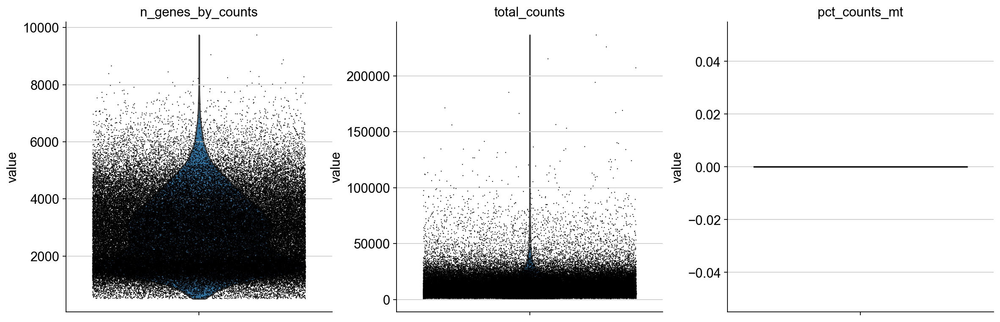

In [30]:
# remove genes with high mitochondrial content
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
adata.var['mt'] = adata.var_names.str.startswith('Mt-')  # annotate the group of mitochondrial genes as 'mt'
adata.var['mt'] = adata.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

In [31]:
results_file

'/Users/davidnat/Documents/projects/greenelab/buddi_test/buddi_analysis/sc_preprocessing/0_qc_notebooks/../../data/single_cell_data/synovium//synovium_processed.h5ad'

In [32]:
# write it out before normalization
adata.__dict__['_raw'].__dict__['_var'] = adata.__dict__['_raw'].__dict__['_var'].rename(columns={'_index': 'features'})
del adata.raw
adata.write(results_file)


normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


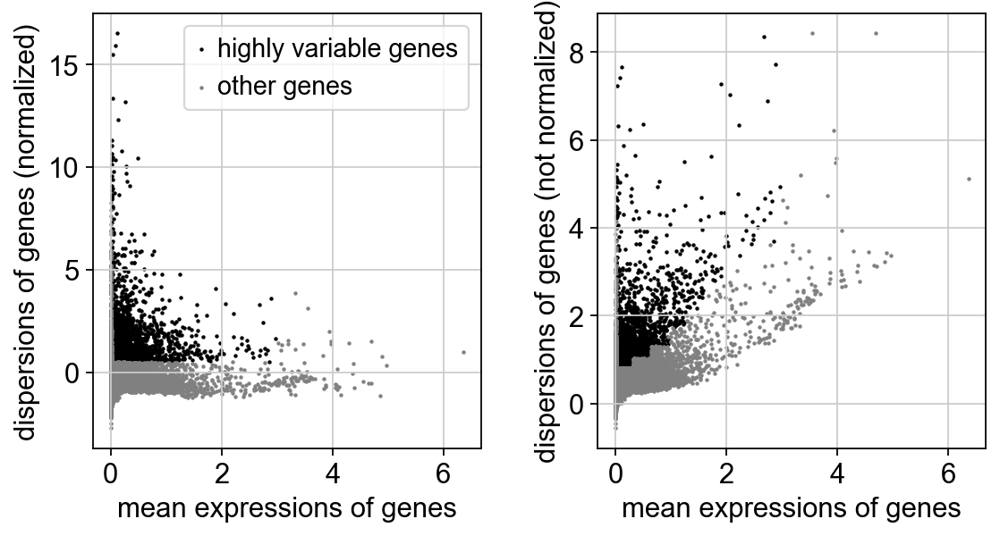

In [33]:
# first get qc info
sc.pp.calculate_qc_metrics(adata, inplace=True)

# normalize to 10K counts per cell
sc.pp.normalize_total(adata, target_sum=1e4)

# log data
sc.pp.log1p(adata)

# get high variance genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

# and plot
sc.pl.highly_variable_genes(adata)

# now store the raw version of the data for our use later
adata.raw = adata


In [34]:
# now process the counts further for doing DE 
# analysis and the cell clustering
adata = adata[:, adata.var.highly_variable]

# scale the genes
sc.pp.scale(adata, max_value=10)

/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


## PCA

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:13)


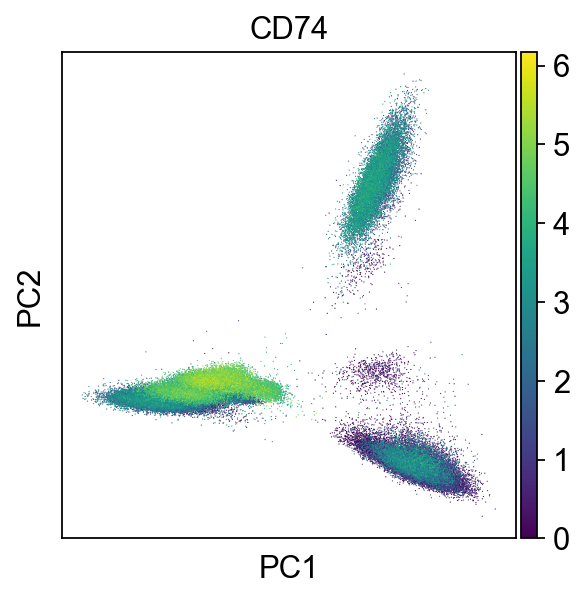

In [35]:
sc.tl.pca(adata, n_comps=50)
sc.pl.pca(adata, color='CD74')


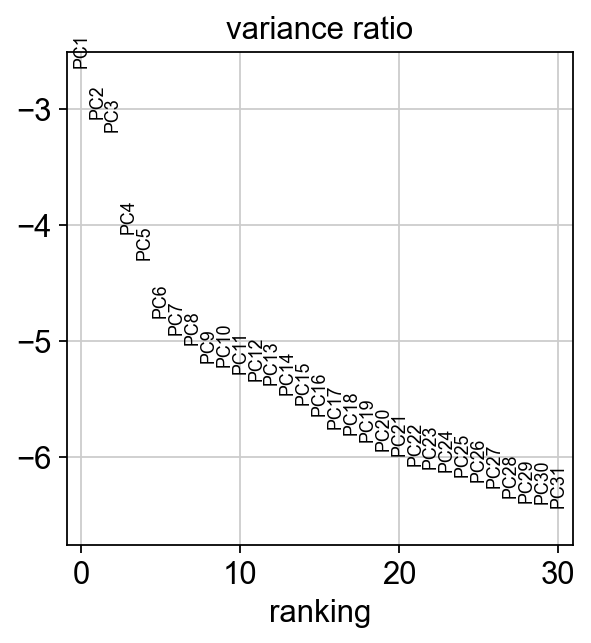

In [36]:
sc.pl.pca_variance_ratio(adata, log=True)


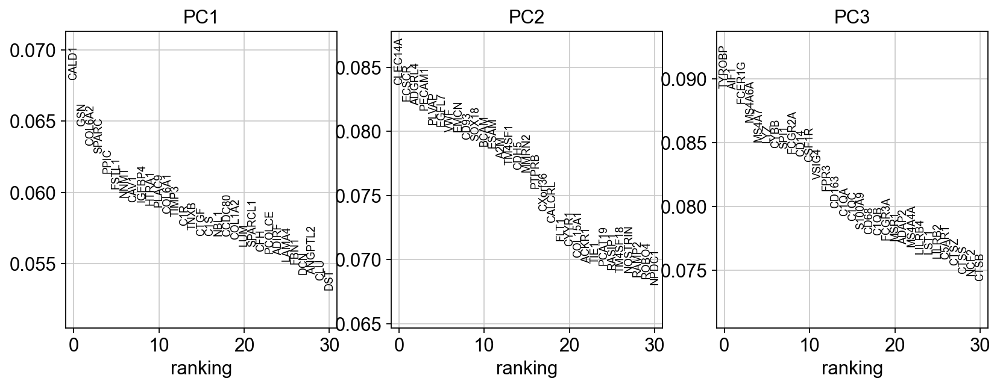

In [37]:
sc.pl.pca_loadings(adata, include_lowest=False)


## Compute and embed neighborhood graph

In [38]:
# calculate neighborhood graph
sc.pp.neighbors(adata)

# make umap
sc.tl.umap(adata)


computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:42)


In [39]:
sc.external.pp.bbknn(adata, batch_key='sample')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:25)


## Cluster the neighborhood graph

running Leiden clustering
    finished: found 17 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:01:54)


/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


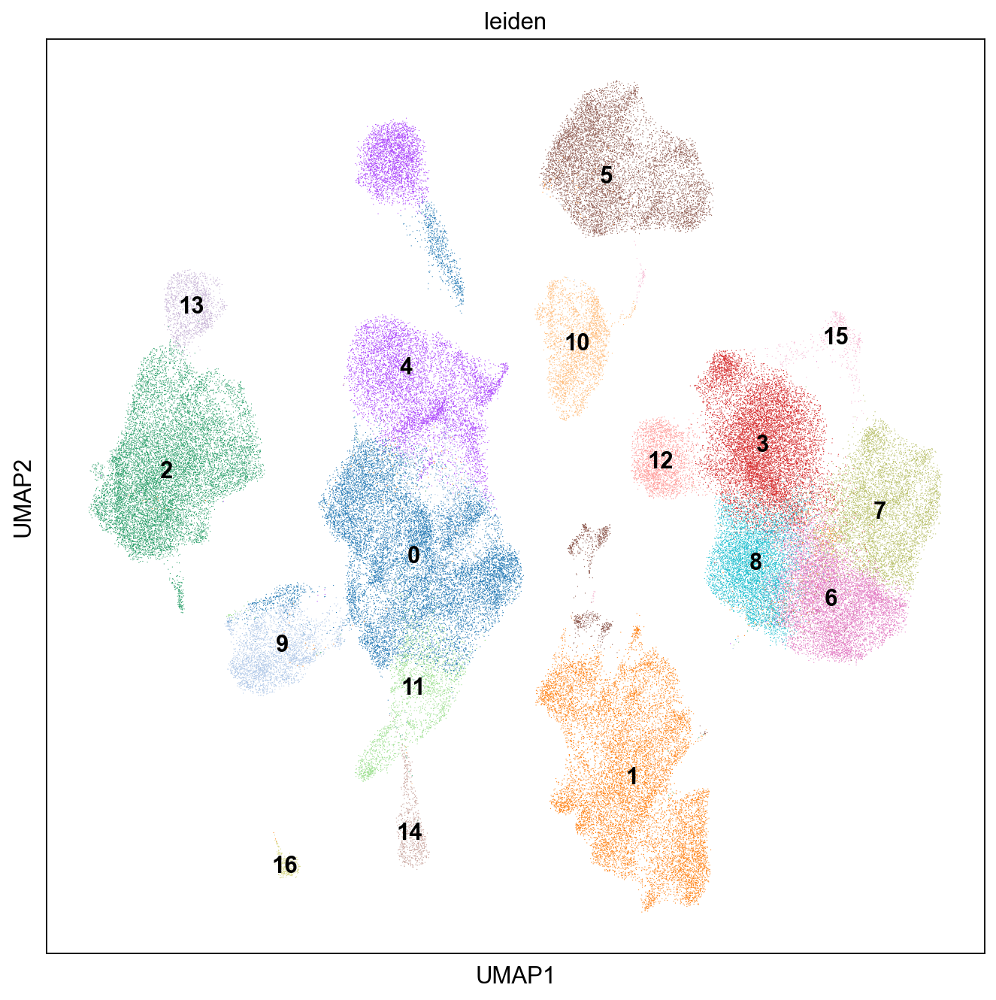

In [40]:
# lets use Leiden clustering
sc.tl.leiden(adata, resolution=0.7)
with rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(adata, color='leiden', legend_loc='on data')



/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


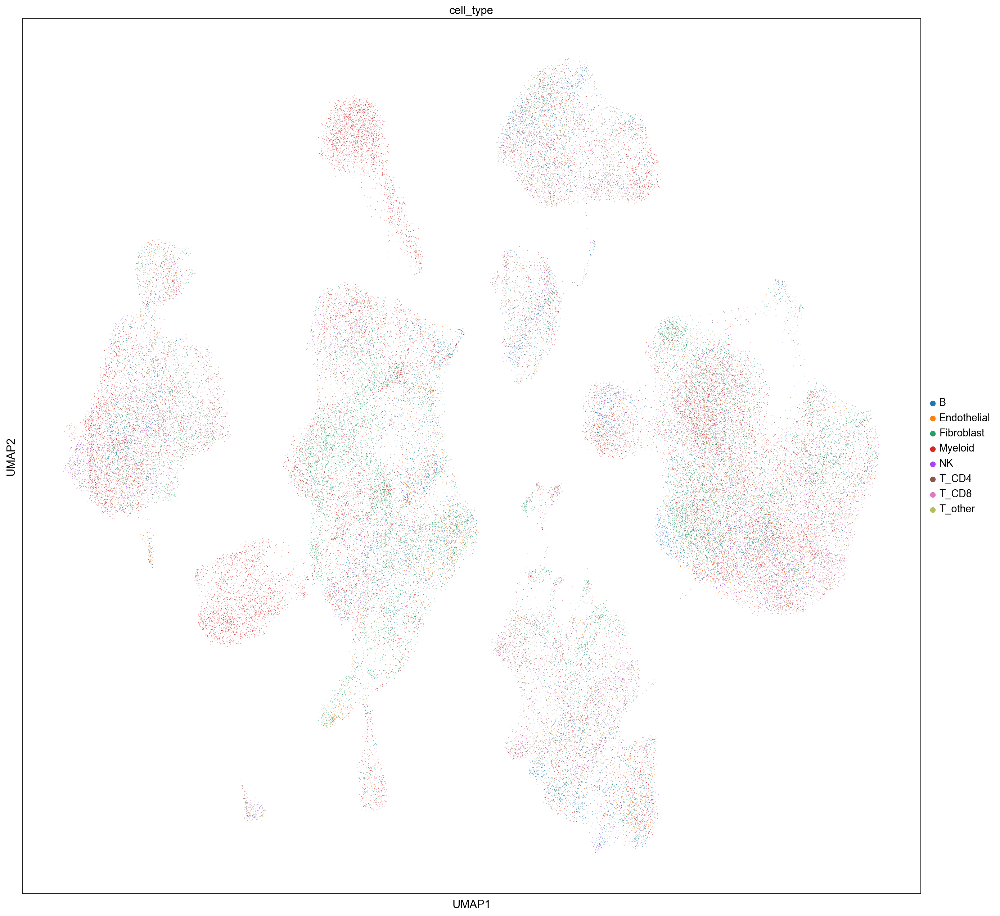

In [41]:
# lets use previously identified clustering
with rc_context({'figure.figsize': (20, 20)}):
    sc.pl.umap(adata, color='cell_type', legend_loc='right margin')


/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


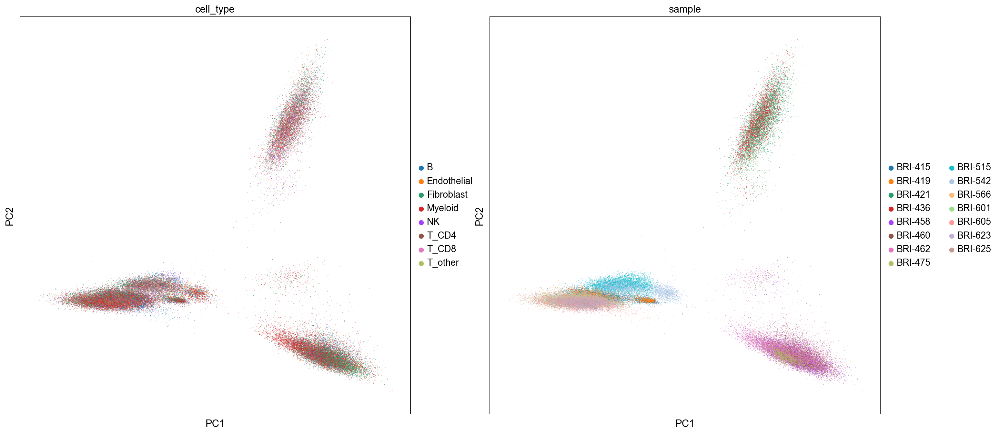

In [42]:
# lets use previously identified clustering
with rc_context({'figure.figsize': (10, 10)}):
    sc.pl.pca(adata, color=['cell_type', 'sample'])


/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


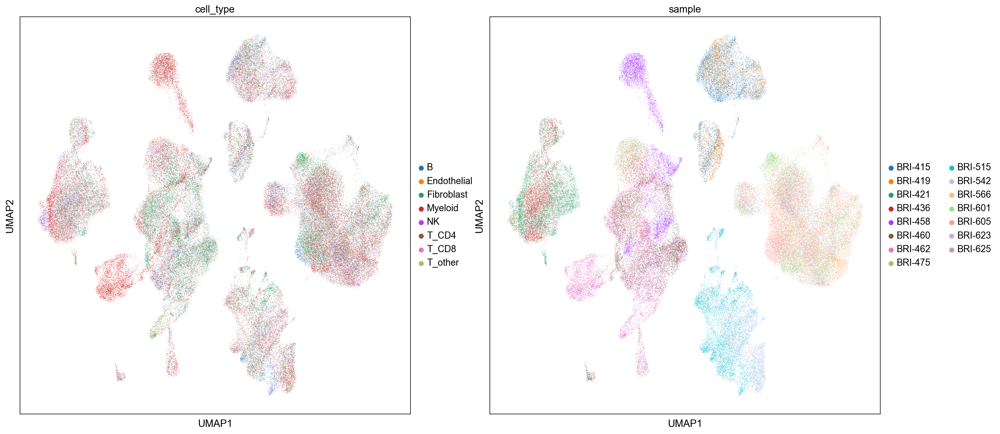

In [43]:
# lets use previously identified clustering
with rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(adata, color=['cell_type', 'sample'])


In [44]:
adata.obs.columns

Index(['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell', 'sample',
       'cluster_number', 'cluster_name', 'cell_type', 'cell_type_orig',
       'subject_id', 'pipeline_date', 'site', 'treatment', 'biopsied', 'sex',
       'age', 'CDAI', 'disease_duration', 'tissue_type', 'krenn_lining',
       'krenn_inflammation', 'single_cell_tech', 'cell_count_to_10x',
       'mRNA_run', 'protein_run', 'atac_run', 'qc', 'immune_cell', 'n_genes',
       'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt',
       'log1p_n_genes_by_counts', 'log1p_total_counts',
       'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes',
       'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden'],
      dtype='object')

/var/folders/64/dljh4z4j4vq9yn4f7wkb2k1h0000gp/T/ipykernel_83655/414734426.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs.sample_interest.iloc[np.where(np.isin(adata.obs["sample"], pseudobulk_samples))[0]] = "pseudobulk_samples"
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


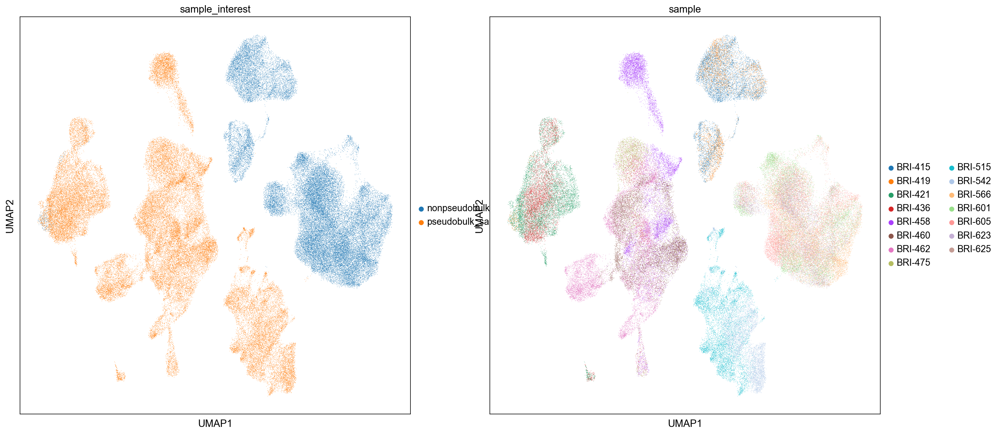

In [45]:
adata.obs["sample_interest"] = "nonpseudobulk_samples" 

pseudobulk_samples = ['BRI-421', 'BRI-436', 'BRI-458', 'BRI-460',
                        'BRI-462', 'BRI-475', 'BRI-515', 'BRI-542']


adata.obs.sample_interest.iloc[np.where(np.isin(adata.obs["sample"], pseudobulk_samples))[0]] = "pseudobulk_samples" 
with rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(adata, color=['sample_interest', 'sample'])


/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


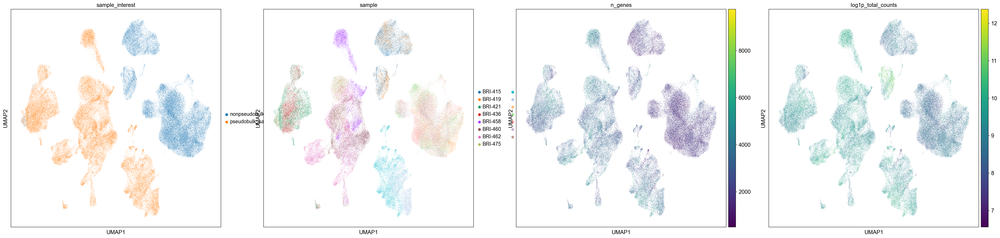

In [46]:
with rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(adata, color=['sample_interest', 'sample', 'n_genes', 'log1p_total_counts'])

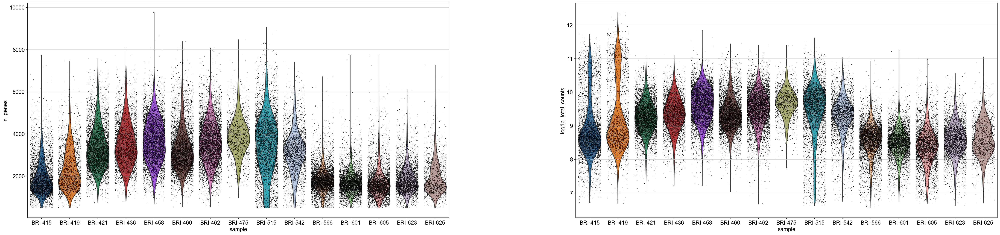

In [47]:
with rc_context({'figure.figsize': (15, 10)}):
    sc.pl.violin(adata, ['n_genes', 'log1p_total_counts'],
             jitter=0.4, groupby = 'sample')

/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


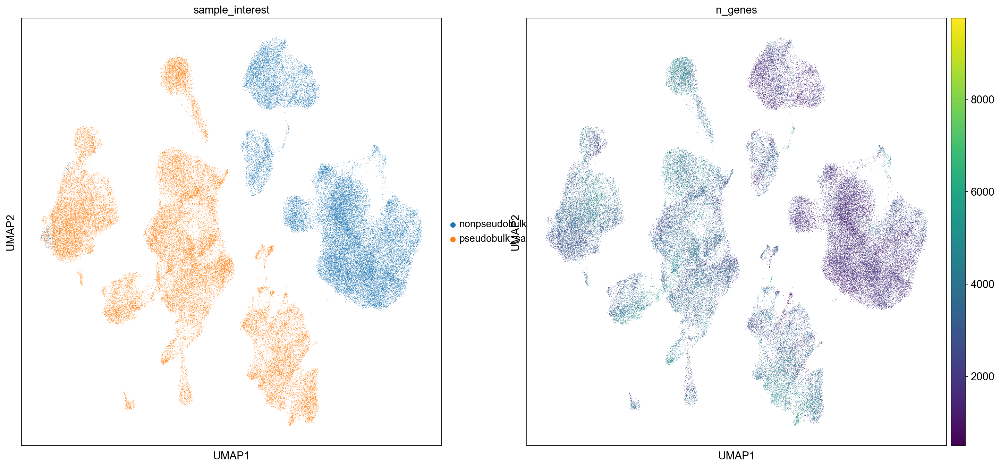

In [48]:
adata.obs.sample_interest.iloc[np.where(np.isin(adata.obs["sample"], pseudobulk_samples))[0]] = "pseudobulk_samples" 
with rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(adata, color=['sample_interest', 'n_genes'])

/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projec

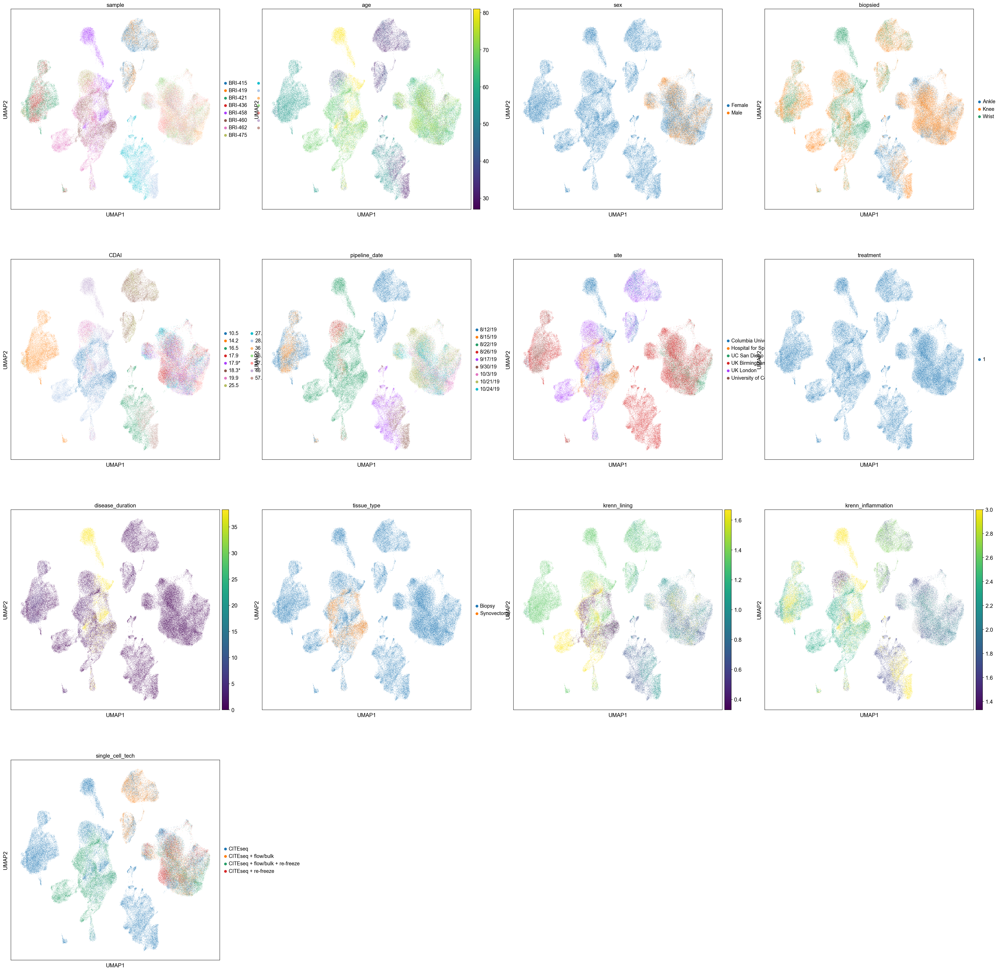

In [49]:
# plot by stimulation
with rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(adata, color=['sample', 'age', 'sex', 'biopsied', 'CDAI', 
                            'pipeline_date', 'site', 'treatment', 'disease_duration', 
                            'tissue_type', 'krenn_lining', 'krenn_inflammation', 'single_cell_tech'])


/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/davidnat/Documents/projects/greenelab/buddi_test/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


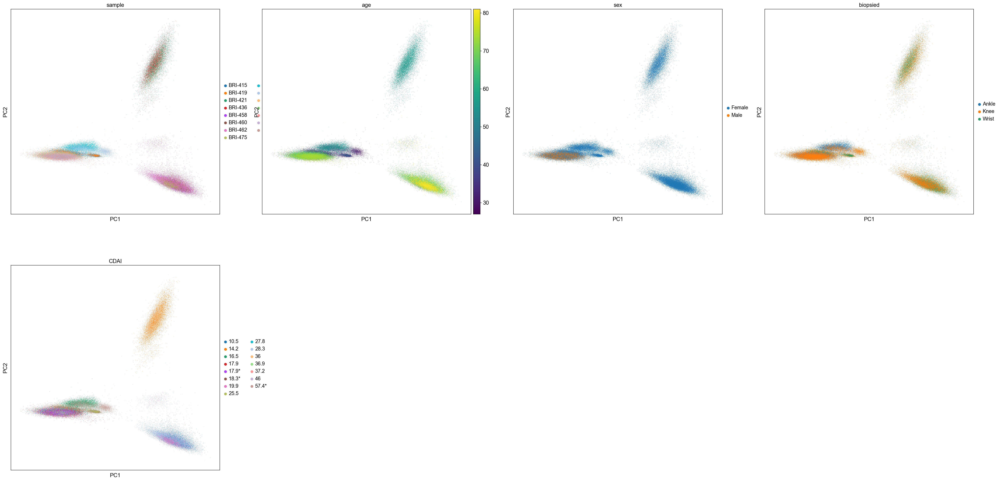

In [50]:
# plot by stimulation
with rc_context({'figure.figsize': (10, 10)}):
    sc.pl.pca(adata, color=['sample', 'age', 'sex', 'biopsied', 'CDAI'])
